## MOwNiT Laboratorium 7 FFT

In [108]:
using FFTW
using Plots
using WAV

### Zadanie 1

Zamień sygnał na sumę sygnałów, zaobserwuj wynik transformaty i wyjaśnij go.

In [109]:
Fs = 1024; #częstotliwość próbkowania

t = 0:1/(Fs-1):1;  #wektor punktów czasowych w przedziale [0 1] co 1/Fs

x = sin.(2*pi*t*200) + sin.(2*pi*t*250) + 2* sin.(2*pi*t*400) #wartość sygnału

1024-element Array{Float64,1}:
  0.0                   
  3.206397697456807     
 -1.2565655116460046    
  0.2590036680701391    
 -1.9036965297357393    
  0.286086022608519     
  2.74237791671497      
 -2.2276933314984397    
  0.7707785405886907    
 -0.2872588952858487    
 -1.0038472033924424    
  1.7834048932188802    
 -1.4568596145201813    
  ⋮                     
 -1.7834048932188513    
  1.0038472033925308    
  0.2872588952858083    
 -0.7707785405888203    
  2.227693331498453     
 -2.742377916714946     
 -0.28608602260847016   
  1.9036965297355481    
 -0.2590036680701193    
  1.2565655116460508    
 -3.2063976974568296    
 -1.2142058848921225e-13

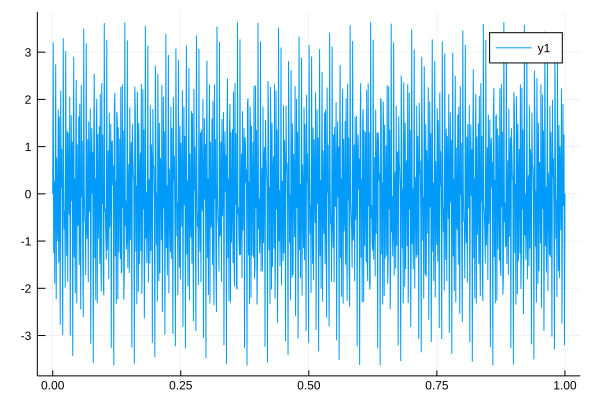

In [110]:
plot(t,x)

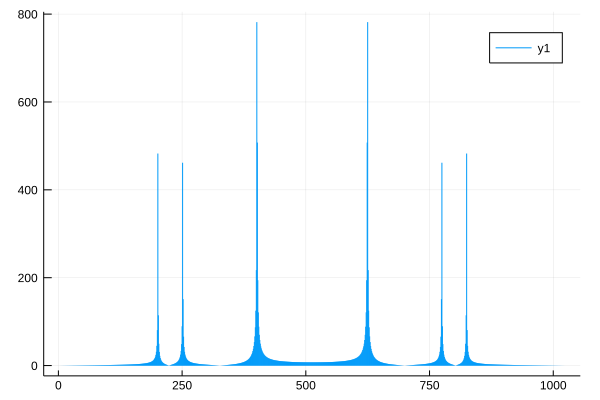

In [111]:
# wykres słupkowy transformaty (moduł z liczb zespolonych).
sticks((abs.(fft(x))))

### Zadanie 2

Usuwanie szumów:

- Wypełniamy tablicę wartościami funkcji cosinus ("sygnału") zaburzonej niewielkim "szumem" np. dodając do każdej wartości wylosowaną liczbę funkcją rand().
- Prosze narysować wykres zaszumionej funkcji.
- Narysować wykres transformaty Fouriera (widmo) tego sygnału (jak poprzednio).
- Po transformacie wyzerowac w widmie wszystkie elementy, których wartość bezwzględna jest mniejsza niz 50. W ten sposób usuwamy "szumy" z sygnału. 5.Przeprowadzić odwrotną transformatę funkcją ifft(). Narysować wykres otrzymanej funkcji dla częsci rzeczywistej. Porównać z wejściowym wykresem sygnału.

In [112]:
Fs = 1024; #częstotliwość próbkowania

t = 0:1/(Fs-1):1;  #wektor punktów czasowych w przedziale [0 1] co 1/Fs

x = map(x->x+(rand()-rand())/2,cos.(2*pi*t*10))

1024-element Array{Float64,1}:
 1.011768265522782 
 1.1370693940365717
 1.0866086737724667
 1.1385184790668923
 0.8604123381930329
 0.6542410945691918
 1.1075273458106865
 1.1999809685359808
 0.8187435076552501
 1.0318253637146952
 0.6821018881533418
 0.5113389383744905
 0.781113514081686 
 ⋮                 
 0.7112363768758798
 0.8300094859974289
 0.6393324984569603
 0.886763539459279 
 0.8169742708602439
 1.1826136359101023
 0.5686919896153905
 0.5574398473131162
 0.9151622559714802
 0.9609580315434944
 0.8592876936864587
 1.1488687740906394

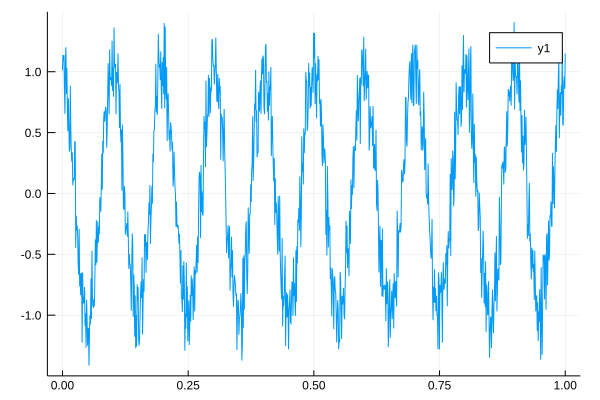

In [113]:
plot(t,x)

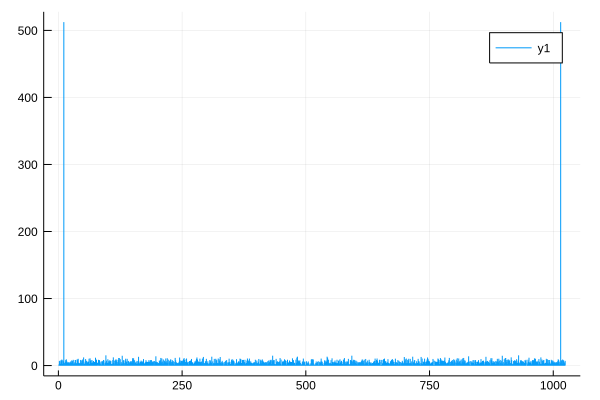

In [114]:
# wykres słupkowy transformaty (moduł z liczb zespolonych).
sticks((abs.(fft(x))))

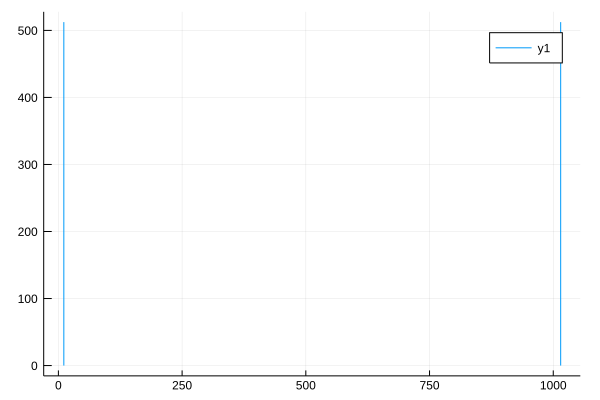

In [119]:
fftX = abs.(fft(x))
fftX = map(x -> if abs(x)<50 0 else x end,fftX)
sticks(fftX)

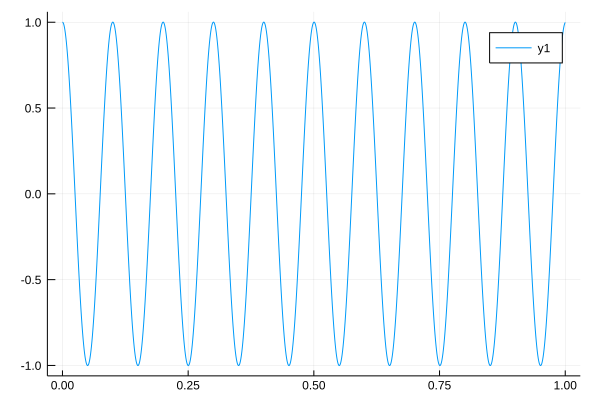

In [117]:
plot(t,map(x -> x.re,ifft(fftX)))

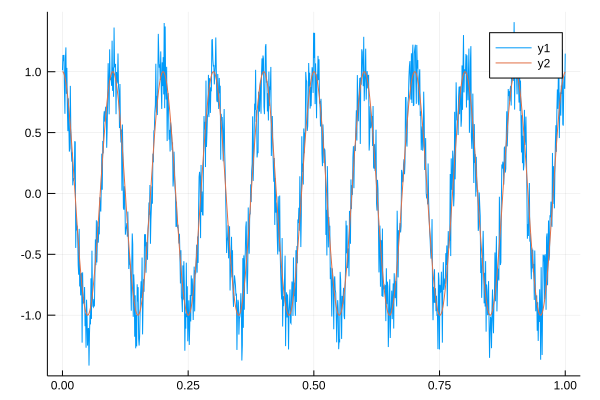

In [118]:
plot(t,x)
plot!(t,map(x -> x.re,ifft(fftX)))

### Zadanie 3
Proszę nagrać własny glos i zastosować na nim trasformatę Fouriera, narysować wykres widma. Następnie poeksperymentować (wyciąć wybrane częstotliwości), dokonać odwrotnej transformaty i odsłuchać efekt.

In [94]:
name="rum"
snd, sampFreq = wavread(string(name,".wav"))

([0.0 0.0; 0.0 0.0; … ; 0.0 0.0; 0.0 0.0], 32000.0f0, 0x0010, WAVChunk[WAVChunk(Symbol("fmt "), UInt8[0x10, 0x00, 0x00, 0x00, 0x01, 0x00, 0x02, 0x00, 0x00, 0x7d, 0x00, 0x00, 0x00, 0xf4, 0x01, 0x00, 0x04, 0x00, 0x10, 0x00]), WAVChunk(:LIST, UInt8[0x49, 0x4e, 0x46, 0x4f, 0x49, 0x53, 0x46, 0x54, 0x0e, 0x00  …  0x35, 0x38, 0x2e, 0x32, 0x33, 0x2e, 0x31, 0x30, 0x32, 0x00])])

In [95]:
s1 = snd[:,1]

182016-element Array{Float64,1}:
 0.0
 0.0
 0.0
 0.0
 0.0
 0.0
 0.0
 0.0
 0.0
 0.0
 0.0
 0.0
 0.0
 ⋮  
 0.0
 0.0
 0.0
 0.0
 0.0
 0.0
 0.0
 0.0
 0.0
 0.0
 0.0
 0.0

In [96]:
points = length(s1)
points / sampFreq

5.688f0

In [97]:
timeArray = (0:(points-1)) / sampFreq
timeArray = timeArray * 1000 #scale to milliseconds

0.0f0:0.03125f0:5687.969f0

In [98]:
plot(timeArray,s1,xlabel="Time (ms)",ylabel="Amplitude",label="chanel1",title="Tone")

In [99]:
Fft = abs.(fft(s1))

182016-element Array{Float64,1}:
 145.63979003265482   
   2.6320073826634283 
   7.5849600360067875 
   3.4654609558581937 
   8.769153474090155  
   0.18160629639077586
   8.33709383127516   
   3.046715451913857  
   4.867352669677115  
   6.031688575901225  
   2.1844219098828535 
   6.6349355370327485 
   7.9675345573044405 
   ⋮                  
   7.96753455730443   
   6.634935537032759  
   2.1844219098828503 
   6.0316885759012235 
   4.8673526696771106 
   3.0467154519138684 
   8.337093831275173  
   0.18160629639076625
   8.769153474090146  
   3.4654609558582044 
   7.584960036006793  
   2.632007382663422  

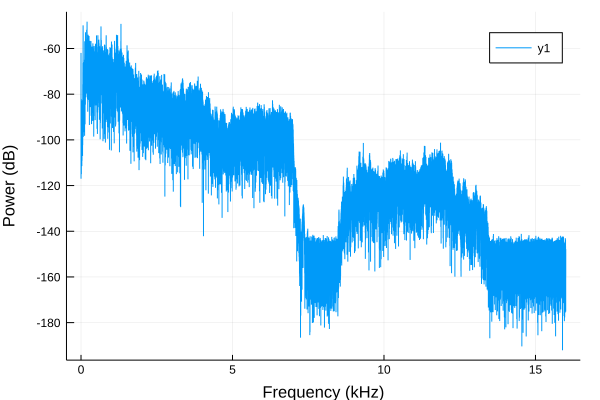

In [100]:
n = length(s1)
Fft = fft(s1)
p=Fft

nUniquePts = ceil(Int, (n+1)/2)
p = p[1:nUniquePts]
p = abs.(p) 

p = p / n #scale
p = p.^2  # square it
# odd nfft excludes Nyquist point
if n % 2 > 0
    p[2:length(p)] = p[2:length(p)]*2 # we've got odd number of   points fft
else 
    p[2: (length(p) -1)] = p[2: (length(p) -1)]*2 # we've got even number of points fft
end

freqArray = (0:(nUniquePts-1)) * (sampFreq / n)



plot(freqArray./1000,map(x -> 10*log(10,x),p),xlabel="Frequency (kHz)",ylabel="Power (dB)")


In [101]:
Fft = fft(s1)
freqArray = (0:(points-1)) * (sampFreq/points)
plot(freqArray, abs.(Fft),xlabel="Frequency [Hz]",ylabel="Amplitude")

In [102]:
res1 = map(x -> x.re,ifft(Fft))
wavwrite(res1,string(name,"1.wav"),Fs=sampFreq)

można wycinać wszystko poniżej 100 Hz

In [103]:
Fft2=copy(Fft)
for i in 1:length(freqArray)
    if freqArray[i]<200
        Fft2[i]=0.0+0.0im
    end
end
res = map(x -> x.re,ifft(Fft2))
wavwrite(res,string(name,"2.wav"),Fs=sampFreq)
plot(freqArray, abs.(Fft2),xlabel="Frequency [Hz]",ylabel="Amplitude")

podbicie zakresu 2-5 kHz poprawi zrozumiałości i przejrzystość

In [104]:
Fft3=copy(Fft2)
for i in 1:length(freqArray)
    if freqArray[i]>2000 && freqArray[i]<5000
        Fft3[i]=20*Fft3[i]
    end
end
res = map(x -> x.re,ifft(Fft3))
wavwrite(res,string(name,"3.wav"),Fs=sampFreq)
plot(freqArray, abs.(Fft3),xlabel="Frequency [Hz]",ylabel="Amplitude")

podbicie zakresu 3-6 kHz doda jasności

In [105]:
Fft4=copy(Fft2)
for i in 1:length(freqArray)
    if freqArray[i]>3000 && freqArray[i]<6000
        Fft4[i]=20*Fft4[i]
    end
end
res = map(x -> x.re,ifft(Fft4))
wavwrite(res,string(name,"4.wav"),Fs=sampFreq)
plot(freqArray, abs.(Fft4),xlabel="Frequency [Hz]",ylabel="Amplitude")

podbicie zakresu 4,5-6 kHz zwiększa prezencję brzmienia głosu

In [106]:
Fft5=copy(Fft2)
for i in 1:length(freqArray)
    if freqArray[i]>4500 && freqArray[i]<6000
        Fft5[i]=20*Fft5[i]
    end
end
res = map(x -> x.re,ifft(Fft5))
wavwrite(res,string(name,"5.wav"),Fs=sampFreq)
plot(freqArray, abs.(Fft5),xlabel="Frequency [Hz]",ylabel="Amplitude")

podbicie zakresu 100-300 Hz doda więcej „mocy” do sygnału, ale może też spowodować „dudnienie”.

In [107]:
Fft6=copy(Fft2)
for i in 1:length(freqArray)
    if freqArray[i]>100 && freqArray[i]<300
        Fft6[i]=20*Fft6[i]
    end
end
res = map(x -> x.re,ifft(Fft6))
wavwrite(res,string(name,"6.wav"),Fs=sampFreq)
plot(freqArray, abs.(Fft6),xlabel="Frequency [Hz]",ylabel="Amplitude")